In [1]:
# Install dependencies
!pip install pyyaml==5.1
!pip install opencv-python-headless

# Install other necessary libraries
!pip install tensorboard

# install weights and biasses
!pip install wandb -qU

import sys, os, distutils.core

# download detr2 model
!git clone 'https://github.com/facebookresearch/detectron2'

# install dependencies
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}

sys.path.insert(0, os.path.abspath('./detectron2'))

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 7.2 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.7/6.7 MB 74.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 28.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 289.2/289.2 kB 32.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 8.3 MB/s eta 0:00:00
Cloning into 'detectron2'...
remote: Enumerating objects: 15713, done.
remote: Counting objects: 100% (436/4

In [ ]:
import wandb

In [ ]:
# this needs to be in a separate cell ¯\_(ツ)_/¯
# The key is specific to the project and should not be used anywhere else
wandb.login(key="f9ef21714bde357dd61c15df3f3852899ecf0ab2")

wandb: W&B API key is configured. Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

In [ ]:
# ensure a GPU is detectable and working
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2023 NVIDIA Corporation
Built on Tue_Aug_15_22:02:13_PDT_2023
Cuda compilation tools, release 12.2, V12.2.140
Build cuda_12.2.r12.2/compiler.33191640_0
torch:  2.3 ; cuda:  cu121
detectron2: 0.6


In [ ]:
# mount gdrive
from google.colab import drive
drive.mount('/content/drive')

FOLDERNAME = 'ColabNotebooks/cs231nfinalproject/datasets/'
assert FOLDERNAME is not None, "[!] Enter the foldername."

import sys
sys.path.append('/content/drive/My Drive/{}'.format(FOLDERNAME))

%cd /content/drive/My\ Drive/$FOLDERNAME
%ls /content/drive/My\ Drive/$FOLDERNAME

Mounted at /content/drive
/content/drive/.shortcut-targets-by-id/1_I-twoaq8VpDwQ0JB4QDGiVs13228tDx/cs231nfinalproject/datasets
 detectron2/       frame000167.jpg        frame000541.jpg   frame001218.jpg   frame001720.jpg
 frame000001.jpg   frame000179.jpg        frame000633.jpg   frame001381.jpg   frame001898.jpg
 frame000051.jpg   frame000293.jpg        frame000794.jpg   frame001391.jpg   frame001978.jpg
 frame000056.jpg   frame000302.jpg        frame000797.jpg   frame001419.jpg   frame001995.jpg
 frame000089.jpg  'frame000305 (1).jpg'   frame000912.jpg   frame001429.jpg   merged_dataset.zip
 frame000092.jpg   frame000305.jpg        frame000933.jpg   frame001469.jpg   output/
 frame000106.jpg   frame000336.jpg        frame001025.jpg   frame001584.jpg   uploaded_images/
 frame000164.jpg   frame000518.jpg        frame001078.jpg   frame001707.jpg   wandb/


## Load custom dataset...

In [ ]:
# !cp /content/drive/My\ Drive/$FOLDERNAME/merged_dataset.zip /content/dataset.zip

# # Unzip the dataset
# !unzip -qq /content/dataset.zip -d /content/dataset
!ls /content/dataset

merged_dataset


## Initialization and register datasets

In [ ]:
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.data.datasets import register_coco_instances
from pathlib import Path

# get the merged dataset and make sure the path variable is correct
dataset_path = Path("/content/dataset/merged_dataset")
annotations_path = dataset_path / "annotations"

assert dataset_path.exists(), f"Dataset path does not exist. \n{dataset_path=}"
assert annotations_path.exists(), f"Annotations path does not exist. \n{annotations_path=}"

training_dataset = "custom_train"
validation_dataset = "custom_val"
test_dataset = "custom_test"
all_datasets = [training_dataset, validation_dataset, test_dataset]


# Register the custom datasets in detr
def unregister_dataset(name):
    if name in MetadataCatalog:
        del MetadataCatalog[name]
    if name in DatasetCatalog:
        del DatasetCatalog[name]

def register_dataset(name, json_file:Path, image_root:Path):
    assert json_file.is_file(), f"JSON file does not exist at:{json_file}"
    assert image_root.is_dir(), f"Image root does not exist at: {image_root}"
    unregister_dataset(name)  # Unregister the dataset if already registered
    print(f"\nRegistering dataset: {name} ...")
    register_coco_instances(name, {}, str(json_file), str(image_root))
    print(f"Registered {name} dataset!")


for dataset in all_datasets:
  ret = register_dataset(
      name=dataset,
      json_file=annotations_path / f"{dataset}.json",
      image_root=dataset_path / dataset.replace("custom_", ""),
  )

print(f"-----------------\n# Registered datasets: {len(MetadataCatalog)}")


Registering dataset: custom_train ...
Registered custom_train dataset!

Registering dataset: custom_val ...
Registered custom_val dataset!

Registering dataset: custom_test ...
Registered custom_test dataset!
-----------------
# Registered datasets: 55


## Train

[06/03 07:29:10 d2.data.datasets.coco]: Loaded 9030 images in COCO format from /content/dataset/merged_dataset/annotations/custom_train.json


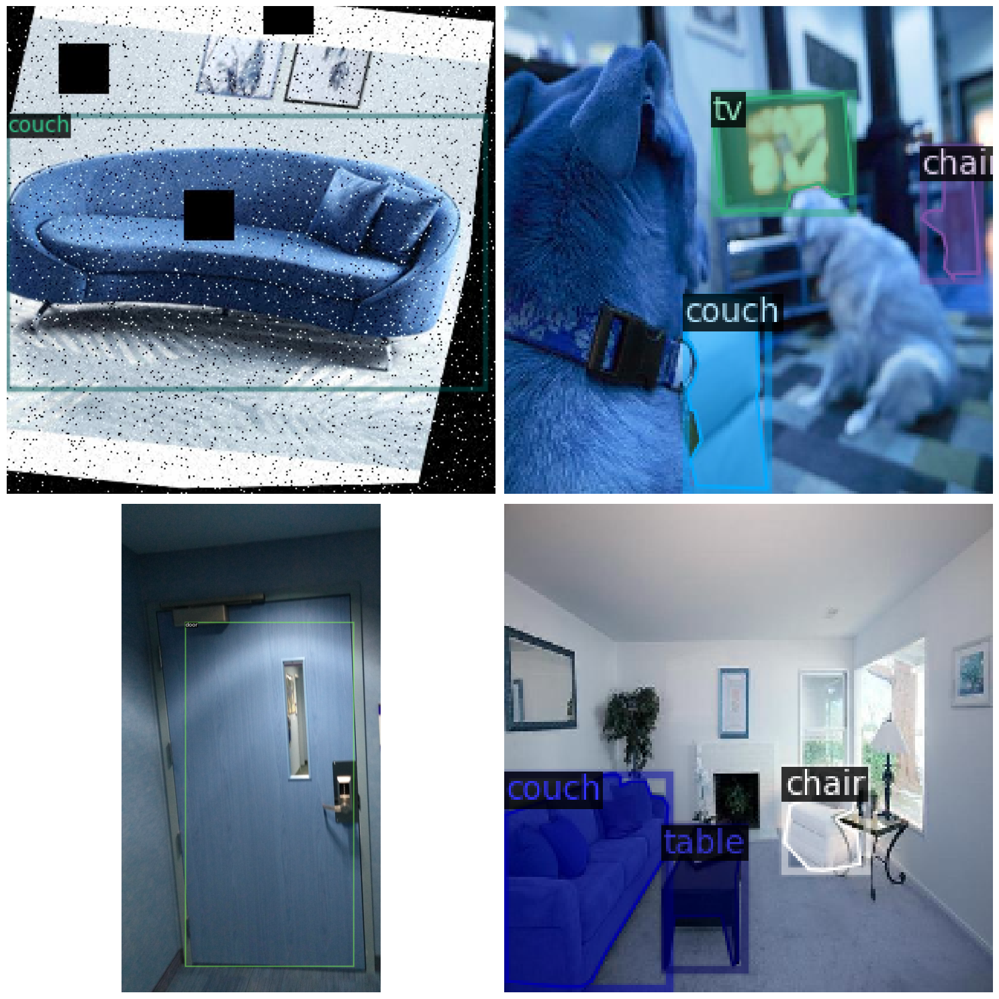

In [ ]:
import random
import matplotlib.pyplot as plt
import math
import cv2
from detectron2.utils.visualizer import Visualizer

# initialize wandb
wandb.init(
    project="detr2-indoors",
    job_type=f"detr_training",
    config={}
)

training_dataset_dicts = DatasetCatalog.get(training_dataset)
training_metadata = MetadataCatalog.get(training_dataset)

# Log dataset information
wandb.config.update({
    "dataset_name": training_dataset,
    "num_samples": len(training_dataset_dicts),
    "labels": training_metadata.thing_classes
})

num_sample_images = 5

sample_images = []
# Log example images from the training data
for i in range(5):  # Log 5 examples
    d = random.choice(training_dataset_dicts)
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=training_metadata, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    img_with_annotations = out.get_image()[:, :, ::-1]

    # Log the image with annotations to wandb
    wandb.log({"examples": [wandb.Image(img_with_annotations, caption=d["file_name"])]})
    sample_images.append(img_with_annotations)

grid_dim = math.floor(math.sqrt(num_sample_images))
# visualize the sample images
fig, axes = plt.subplots(grid_dim, grid_dim, figsize=(15, 15))
axes = axes.flatten()

for img, ax in zip(sample_images, axes):
    ax.imshow(img)
    ax.axis('off')  # Hide the axis

# Remove empty subplots if there are any
for ax in axes[len(sample_images):]:
    fig.delaxes(ax)

plt.tight_layout()
plt.show()

In [ ]:
from detectron2.config import get_cfg
from detectron2 import model_zoo

# model configs
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = (training_dataset,)
cfg.DATASETS.TEST = (validation_dataset,)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 10
cfg.SOLVER.BASE_LR = 0.01
cfg.SOLVER.MAX_ITER = 1000
cfg.MODEL.ROI_HEADS.NUM_CLASSES = len(training_metadata.thing_classes)
cfg.OUTPUT_DIR = "./outputpal"


# log the config
wandb.config.update(cfg)

In [ ]:
import torch
import numpy as np
from detectron2.engine import DefaultTrainer, HookBase
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.data.datasets import register_coco_instances
from detectron2.data import MetadataCatalog, DatasetCatalog, build_detection_train_loader
from detectron2.checkpoint import DetectionCheckpointer
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from io import BytesIO

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

class FeatureExtractor(torch.nn.Module):
    def __init__(self, model):
        super().__init__()
        self.model = model.to(device)  # Move model to the appropriate device

    def forward(self, images):
        images = images.to(device)  # Move images to the same device as the model
        with torch.no_grad():
            features = self.model.backbone(images)
        return features

# Adjust collect_features based on actual batch structure
def collect_features(data_loader, feature_extractor):
    features_list = []
    labels_list = []

    for batch in data_loader:
        for data in batch:
            images = data["image"].to(device).float() / 255.0  # Convert to float and normalize
            instances = data["instances"]
            labels = instances.gt_classes.to(device)  # Ensure the labels are on the same device
            features = feature_extractor(images.unsqueeze(0))  # Unsqueeze to add batch dimension

            features_list.append(features["0"].cpu().numpy())
            labels_list.append(labels.cpu().numpy())  # Move to CPU for numpy operations

    features_np = np.concatenate(features_list, axis=0)
    labels_np = np.concatenate(labels_list, axis=0)

    return features_np, labels_np

def apply_tsne(features_np):
    tsne = TSNE(n_components=2, random_state=42)
    features_tsne = tsne.fit_transform(features_np)
    return features_tsne

def log_tsne_plot(features_tsne, labels_np):
    df = pd.DataFrame(features_tsne, columns=["x", "y"])
    df["label"] = labels_np

    plt.figure(figsize=(10, 10))
    sns.scatterplot(x="x", y="y", hue="label", palette="tab10", data=df, legend="full", alpha=0.6)
    plt.title("t-SNE of Training Dataset Features")
    plt.xlabel("t-SNE Component 1")
    plt.ylabel("t-SNE Component 2")

    buf = BytesIO()
    plt.savefig(buf, format="png")
    buf.seek(0)

    wandb.log({"t-SNE plot": wandb.Image(buf)})

    plt.clf()

class TrainerWithTsne(DefaultTrainer):
    def __init__(self, cfg):
        super().__init__(cfg)
        self.feature_extractor = FeatureExtractor(self.model)

    # def after_step(self):
    #     super().after_step()
    #     if self.iter % 100 == 0:
    #         data_loader = build_detection_train_loader(self.cfg)
    #         features_np, labels_np = collect_features(data_loader, self.feature_extractor)
    #         features_tsne = apply_tsne(features_np)
    #         log_tsne_plot(features_tsne, labels_np)

    def build_hooks(self):
        hooks = super().build_hooks()
        hooks.insert(-1, WandbHook())
        return hooks

# We care about the following losses in the detr log
# - total_loss is the overall loss being minimized during training.
# - loss_cls is the classification loss for the final object detection stage.
# - loss_box_reg is the bounding box regression loss for the final object detection stage.
# - loss_rpn_cls is the classification loss for the Region Proposal Network .
# - loss_rpn_loc is the localization loss for the Region Proposal Network .
readable_metric_map = {
    "total_loss": "Total loss",
    "loss_cls": "Classification loss",
    "loss_box_reg": "BoundingBox regression loss",
    "loss_rpn_cls": "RPN classification loss",
    "loss_rpn_loc": "RPN localization loss",
    "lr": "learning rate",
}

class WandbHook(HookBase):
    def after_step(self):
        # Log metrics to wandb
        metrics = self.trainer.storage.latest()
        wandb_training_metrics = {}

        for metric in metrics:
            # don't need to track time..
            if "time" in metric:
                continue
            # replace the metric keys with more readable keys
            if metric in readable_metric_map:
                wandb_training_metrics[readable_metric_map[metric]] = metrics[metric][0]
            else:
                wandb_training_metrics[metric] = metrics[metric][0]

        wandb.log(wandb_training_metrics)

In [ ]:
# train
trainer = TrainerWithTsne(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[06/03 05:56:01 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_280758.pkl: 167MB [00:02, 74.9MB/s]                          
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[06/03 05:56:04 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.10/dist-packages/torch/functional.py:512: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3587.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[06/03 05:56:13 d2.utils.events]:  eta: 0:02:34  iter: 19  total_loss: 2.274  loss_cls: 2.082  loss_box_reg: 0.1673  loss_rpn_cls: 0.02632  loss_rpn_loc: 0.01059    time: 0.1694  last_time: 0.1501  data_time: 0.0117  last_data_time: 0.0042   lr: 0.00019981  max_mem: 1537M
[06/03 05:56:21 d2.utils.events]:  eta: 0:02:34  iter: 39  total_loss: 0.5986  loss_cls: 0.3396  loss_box_reg: 0.162  loss_rpn_cls: 0.02384  loss_rpn_loc: 0.01162    time: 0.1774  last_time: 0.1721  data_time: 0.0055  last_data_time: 0.0053   lr: 0.00039961  max_mem: 1964M
[06/03 05:56:24 d2.utils.events]:  eta: 0:02:30  iter: 59  total_loss: 0.4573  loss_cls: 0.237  loss_box_reg: 0.1773  loss_rpn_cls: 0.01983  loss_rpn_loc: 0.007247    time: 0.1760  last_time: 0.1542  data_time: 0.0049  last_data_time: 0.0055   lr: 0.00059941  max_mem: 1964M
[06/03 05:56:27 d2.utils.events]:  eta: 0:02:25  iter: 79  total_loss: 0.3673  loss_cls: 0.173  loss_box_reg: 0.1648  loss_rpn_cls: 0.0263  loss_rpn_loc: 0.008818    time: 0.1736

In [ ]:
wandb.finish()

BoundingBox regression loss,▅█▄▄▃▆▂▆▂▂▂▆▃▃▂▂▂▂▄▂▆▂▆▅▁▃▅▂▂▁▂▂▂▃▃▃▂▂▄▃
Classification loss,█▂▂▁▂▂▁▂▁▁▁▂▁▁▁▁▁▁▁▁▂▁▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂
RPN classification loss,▃▃█▁▄▂▁▃▁▂▁▃▃▁▁▁▁▂▃▁▃▁▆▄▂▂▃▂▁▆▁▄▃▅▅▆▃▅▃▅
RPN localization loss,▁▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▂▁▁▁▂▁█▂▁▁▂▁▁▁▁▁▁▂▂▃▁▂▁▂
Total loss,█▃▃▂▂▂▁▂▁▁▁▂▂▁▁▁▁▁▂▁▃▁▃▂▁▂▂▁▁▁▁▁▁▂▂▂▁▂▂▂
eta_seconds,████▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁
fast_rcnn/cls_accuracy,▁▇███▇█▇████████████▇█▇▇████████████████
fast_rcnn/false_negative,▁██████▄▇▄▄▄▆▅▆▅▄▄▇▃▆▂▇▇▂█▄▂▂█▅▆▅▆█▆▆▇▆█
fast_rcnn/fg_cls_accuracy,▂▁▁▁▁▁▁▃▁▂▃▅▂▄▄▁▅▆▂▄▃▄▁▂█▁▅▇█▁▅▂▅▃▁▁▃▁▃▁
learning rate,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
roi_head/num_bg_samples,▅▂▆▆▆▄▇▄█▇▇▂▅▆▇▇▇▇▅▇▁▇▃▄▇▆▄▇▇█▆▇▇▆▅▇▇▇▅▅


## Test

In [ ]:
from detectron2.engine import DefaultPredictor

# initialize wandb
wandb.init(
    project="detr2-indoors",
    job_type=f"detr_testing",
    config={}
)

metadata = MetadataCatalog.get(test_dataset)
dataset_dicts = DatasetCatalog.get(test_dataset)

cfg = get_cfg()
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.DATASETS.TEST = (test_dataset,)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = len(metadata.thing_classes)

# log the config
wandb.config.update(cfg)

predictor = DefaultPredictor(cfg)

# Function to run inference and log results to wandb
def run_inference_and_log(dataset_dicts, metadata, predictor):
    for d in dataset_dicts:
        img = cv2.imread(d["file_name"])
        outputs = predictor(img)

        # Visualize the predictions
        v = Visualizer(img[:, :, ::-1], metadata=metadata, scale=0.5)
        out = v.draw_instance_predictions(outputs["instances"].to("cpu"))

        # Log the image with predictions to wandb
        wandb.log({"inference": [wandb.Image(out.get_image()[:, :, ::-1], caption=d["file_name"])]})

# Run inference and log results
run_inference_and_log(dataset_dicts, metadata, predictor)

# Finish the wandb run
wandb.finish()

[06/03 06:12:31 d2.data.datasets.coco]: Loaded 1069 images in COCO format from /content/dataset/merged_dataset/annotations/custom_test.json
[06/03 06:12:32 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


In [ ]:
import wandb
import torch
import numpy as np
from detectron2.engine import DefaultPredictor, DefaultTrainer
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.data.datasets import register_coco_instances
from detectron2.data import MetadataCatalog, DatasetCatalog, build_detection_train_loader
from detectron2.checkpoint import DetectionCheckpointer
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from io import BytesIO

# Initialize wandb
wandb.init(
    project="detr2-indoors",
    job_type=f"detr_tSNE",
    config={}
)

metadata = MetadataCatalog.get(training_dataset)
dataset_dicts = DatasetCatalog.get(training_dataset)

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set a custom testing threshold
cfg.DATASETS.TEST = (test_dataset,)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = len(metadata.thing_classes)

predictor = DefaultPredictor(cfg)

# Identify the device (CPU or GPU)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

class FeatureExtractor(torch.nn.Module):
    def __init__(self, model):
        super().__init__()
        self.model = model.to(device)  # Move model to the appropriate device

    def forward(self, images):
        images = images.to(device).float() / 255.0  # Convert to float and normalize
        with torch.no_grad():
            features = self.model.backbone(images)
        return features

# Initialize the feature extractor with the predictor model
feature_extractor = FeatureExtractor(predictor.model)

def extract_features(data_loader, feature_extractor):
    features_list = []
    labels_list = []

    for batch in data_loader:
        for data in batch:
            images = data["image"].to(device).float() / 255.0  # Convert to float and normalize
            instances = data["instances"]
            labels = instances.gt_classes.to(device)  # Ensure the labels are on the same device
            features = feature_extractor(images.unsqueeze(0))  # Unsqueeze to add batch dimension

            features_list.append(features.cpu().numpy())  # Move to CPU for numpy operations
            labels_list.append(labels.cpu().numpy())  # Move to CPU for numpy operations

    features_np = np.concatenate(features_list, axis=0)
    labels_np = np.concatenate(labels_list, axis=0)

    return features_np, labels_np

def apply_tsne(features_np):
    tsne = TSNE(n_components=2, random_state=42)
    features_tsne = tsne.fit_transform(features_np)
    return features_tsne

def log_tsne_plot(features_tsne, labels_np):
    df = pd.DataFrame(features_tsne, columns=["x", "y"])
    df["label"] = labels_np

    plt.figure(figsize=(10, 10))
    sns.scatterplot(x="x", y="y", hue="label", palette="tab10", data=df, legend="full", alpha=0.6)
    plt.title("t-SNE of Training Dataset Features")
    plt.xlabel("t-SNE Component 1")
    plt.ylabel("t-SNE Component 2")

    buf = BytesIO()
    plt.savefig(buf, format="png")
    buf.seek(0)

    wandb.log({"t-SNE plot": wandb.Image(buf)})

    plt.clf()

# Build data loader
data_loader = build_detection_train_loader(cfg)

# Extract features and apply t-SNE
features_np, labels_np = extract_features(data_loader, feature_extractor)
features_tsne = apply_tsne(features_np)

# Log t-SNE plot to wandb
log_tsne_plot(features_tsne, labels_np)

# Finish the wandb run
wandb.finish()


[06/03 06:50:58 d2.data.datasets.coco]: Loaded 9030 images in COCO format from /content/dataset/merged_dataset/annotations/custom_train.json
[06/03 06:50:58 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...
[06/03 06:50:59 d2.data.datasets.coco]: Loaded 9030 images in COCO format from /content/dataset/merged_dataset/annotations/custom_train.json
[06/03 06:50:59 d2.data.build]: Removed 1326 images with no usable annotations. 7704 images left.
[06/03 06:50:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in training: [ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style='choice'), RandomFlip()]
[06/03 06:50:59 d2.data.build]: Using training sampler TrainingSampler
[06/03 06:50:59 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[06/03 06:50:59 d2.data.common]: Serializing 7704 elements to byte tensors and concatenating them al

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


RuntimeError: The size of tensor a (123) must match the size of tensor b (124) at non-singleton dimension 2

In [ ]:
from detectron2.engine import DefaultPredictor

# Evaluation setup
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set threshold for this model
cfg.DATASETS.TEST = (test_dataset,)
predictor = DefaultPredictor(cfg)

from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

evaluator = COCOEvaluator(test_dataset, cfg, False, output_dir="./outputpal/")
val_loader = build_detection_test_loader(cfg, test_dataset)
evaluation_results = inference_on_dataset(predictor.model, val_loader, evaluator)
print(evaluation_results)


[06/03 06:06:05 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...
[06/03 06:06:05 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [06/03 06:06:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[06/03 06:06:05 d2.data.datasets.coco]: Loaded 1069 images in COCO format from /content/dataset/merged_dataset/annotations/custom_test.json
[06/03 06:06:05 d2.data.build]: Distribution of instances among all 10 categories:
|  category  | #instances   |  category  | #instances   |   category   | #instances   |
|:----------:|:-------------|:----------:|:-------------|:------------:|:-------------|
|    door    | 109          |  cabinet   | 231          | refrigerator | 126          |
|   window   | 63           |   chair    | 721          |    table     | 280          |
|   couch    | 261     

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[06/03 06:06:06 d2.evaluation.evaluator]: Inference done 11/1069. Dataloading: 0.0012 s/iter. Inference: 0.0423 s/iter. Eval: 0.0002 s/iter. Total: 0.0437 s/iter. ETA=0:00:46
[06/03 06:06:11 d2.evaluation.evaluator]: Inference done 125/1069. Dataloading: 0.0015 s/iter. Inference: 0.0422 s/iter. Eval: 0.0002 s/iter. Total: 0.0440 s/iter. ETA=0:00:41
[06/03 06:06:16 d2.evaluation.evaluator]: Inference done 262/1069. Dataloading: 0.0014 s/iter. Inference: 0.0383 s/iter. Eval: 0.0002 s/iter. Total: 0.0400 s/iter. ETA=0:00:32
[06/03 06:06:21 d2.evaluation.evaluator]: Inference done 401/1069. Dataloading: 0.0014 s/iter. Inference: 0.0369 s/iter. Eval: 0.0002 s/iter. Total: 0.0386 s/iter. ETA=0:00:25
[06/03 06:06:26 d2.evaluation.evaluator]: Inference done 540/1069. Dataloading: 0.0014 s/iter. Inference: 0.0363 s/iter. Eval: 0.0002 s/iter. Total: 0.0380 s/iter. ETA=0:00:20
[06/03 06:06:31 d2.evaluation.evaluator]: Inference done 681/1069. Dataloading: 0.0014 s/iter. Inference: 0.0358 s/iter. 

[06/03 05:21:24 d2.data.datasets.coco]: Loaded 1069 images in COCO format from /content/dataset/merged_dataset/annotations/custom_test.json


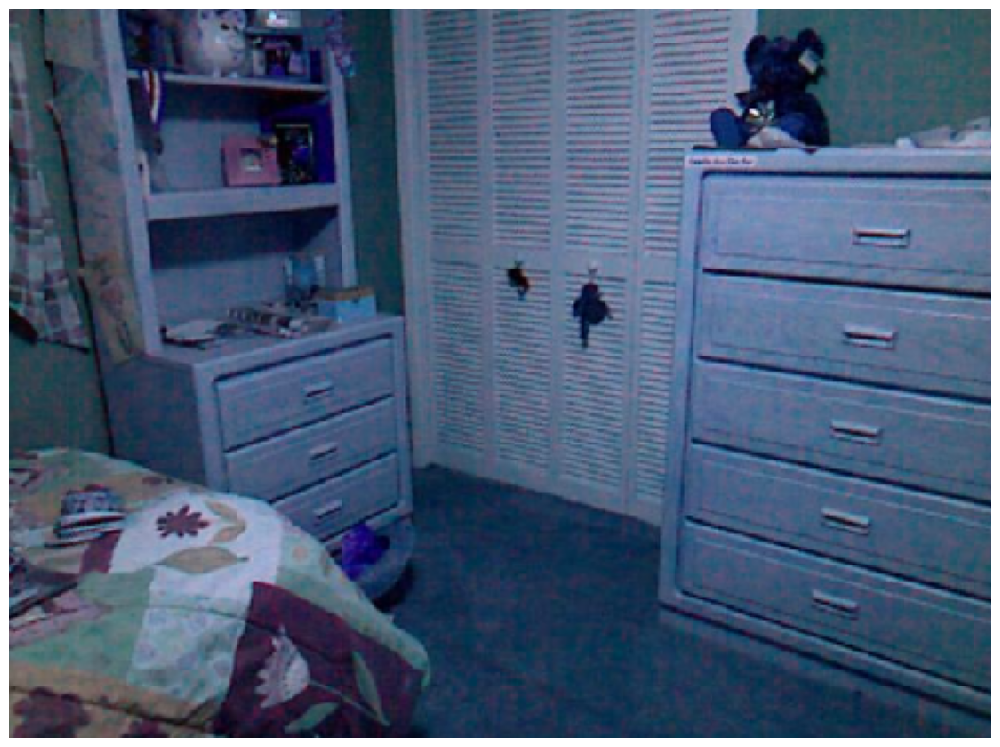

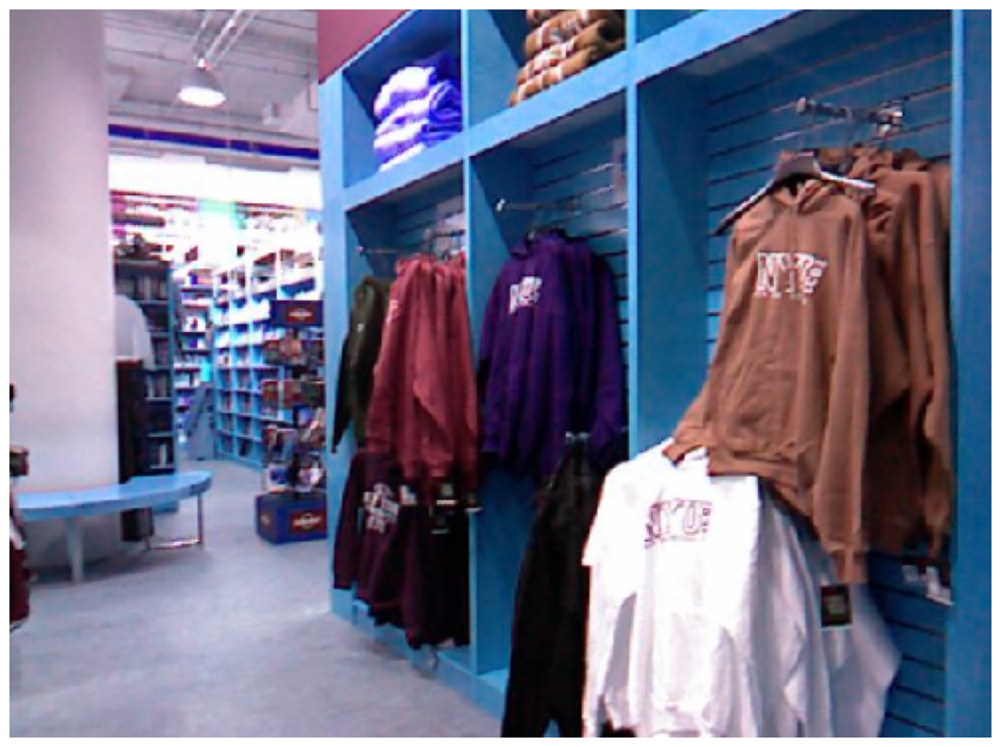

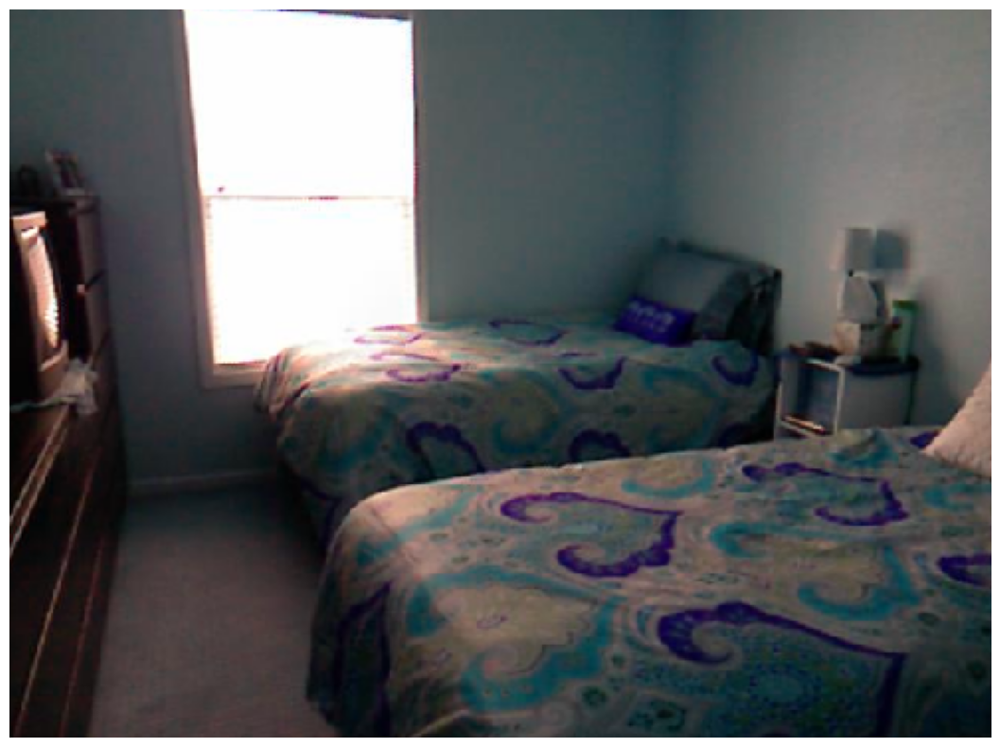

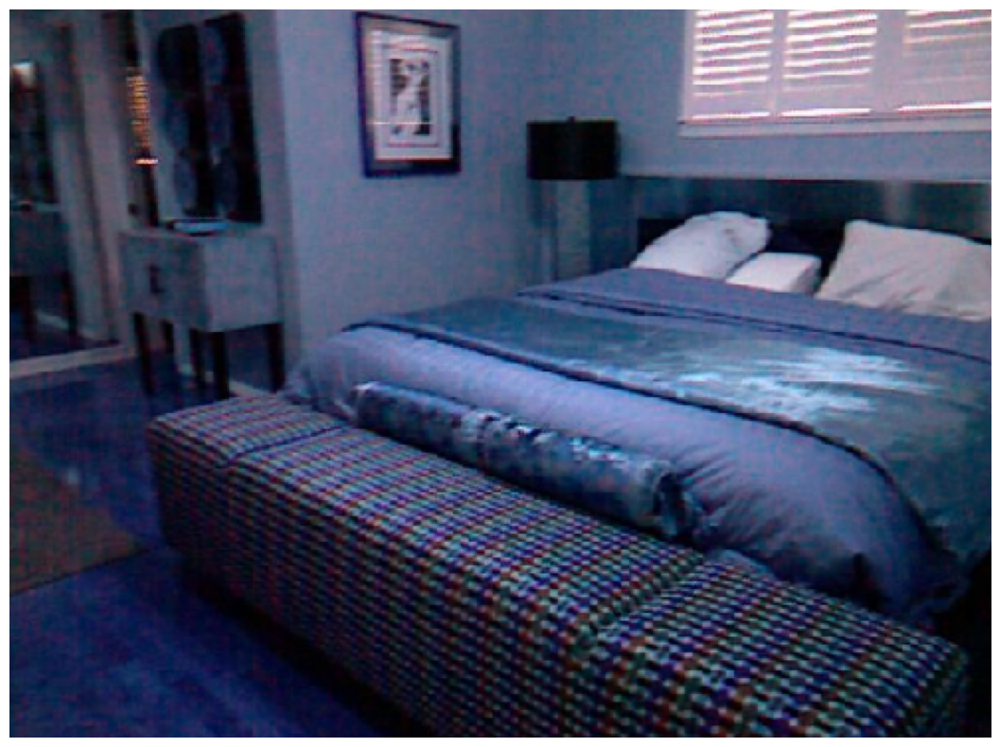

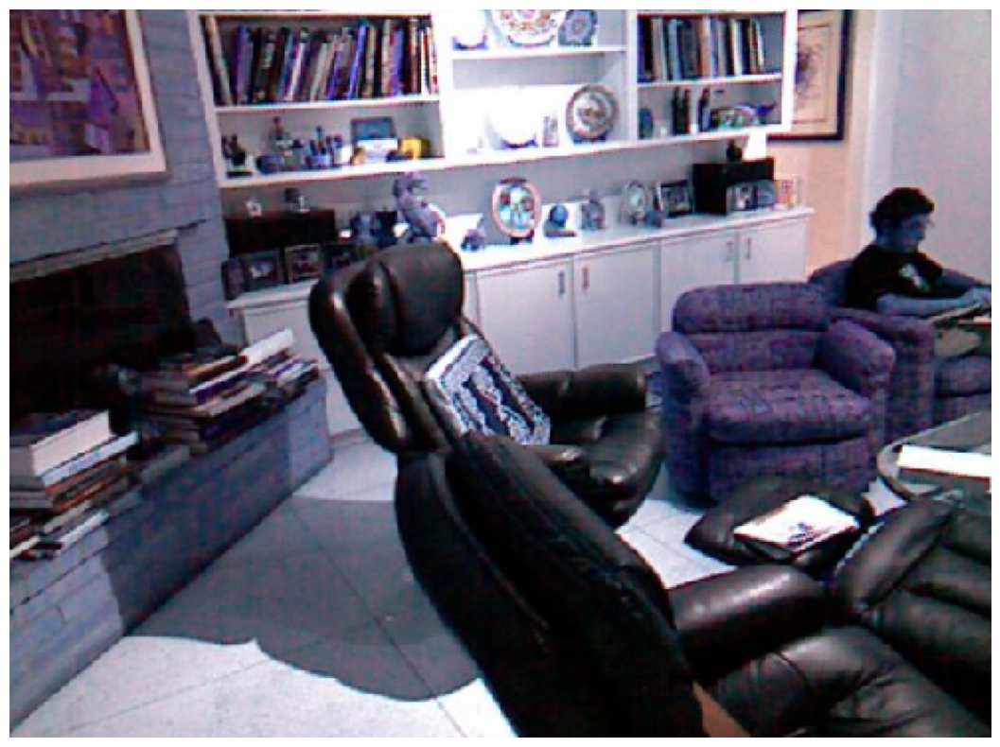

In [ ]:
# Plotting and saving predictions
test_metadata = MetadataCatalog.get(test_dataset)
test_dataset_dicts = DatasetCatalog.get(test_dataset)

os.makedirs("./outputpal/plots", exist_ok=True)  # Directory to save plotted images

for idx, d in enumerate(test_dataset_dicts[:5]):  # Visualize first 5 test images
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)
    v = Visualizer(img[:, :, ::-1], metadata=test_metadata, scale=0.8)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))

    plt.figure(figsize=(14, 10))
    plt.imshow(out.get_image()[:, :, ::-1])
    plt.axis('off')

    plot_path = f"./output/plots/prediction_{idx}.png"
    plt.savefig(plot_path)  # Save the plot
    plt.show()


[06/02 00:02:27 d2.data.datasets.coco]: Loaded 1069 images in COCO format from /content/dataset/merged_dataset/annotations/custom_test.json


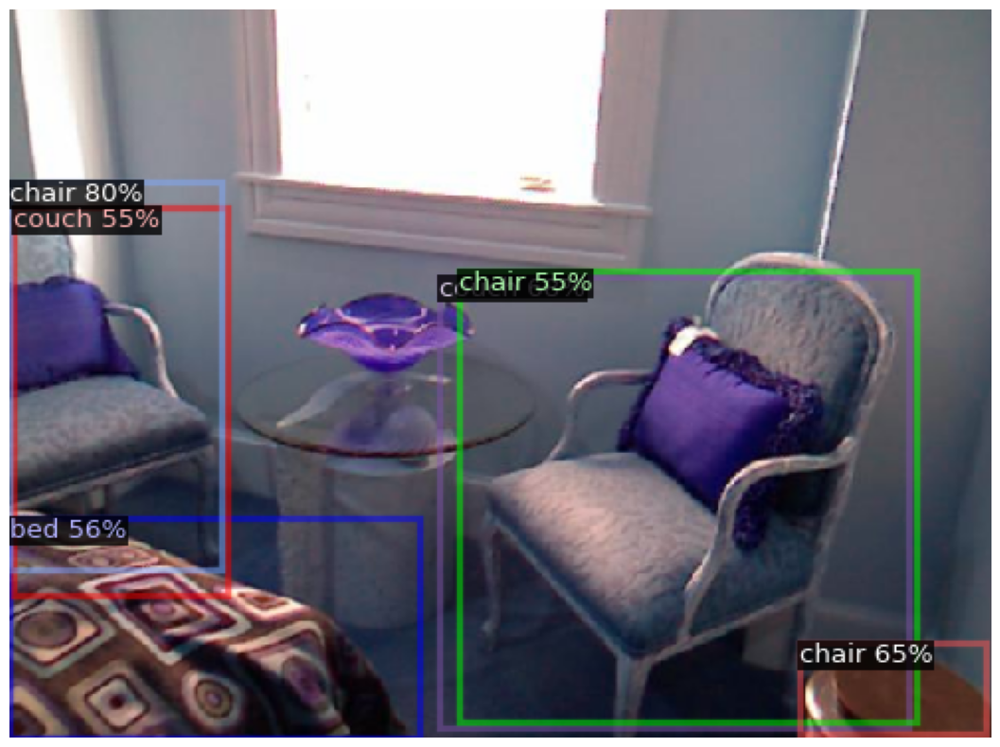

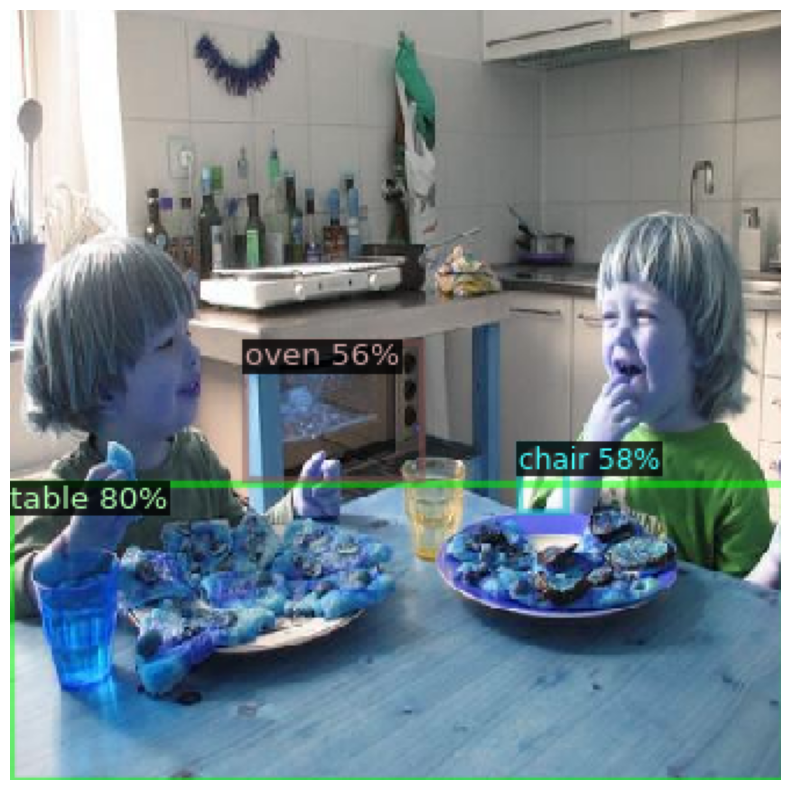

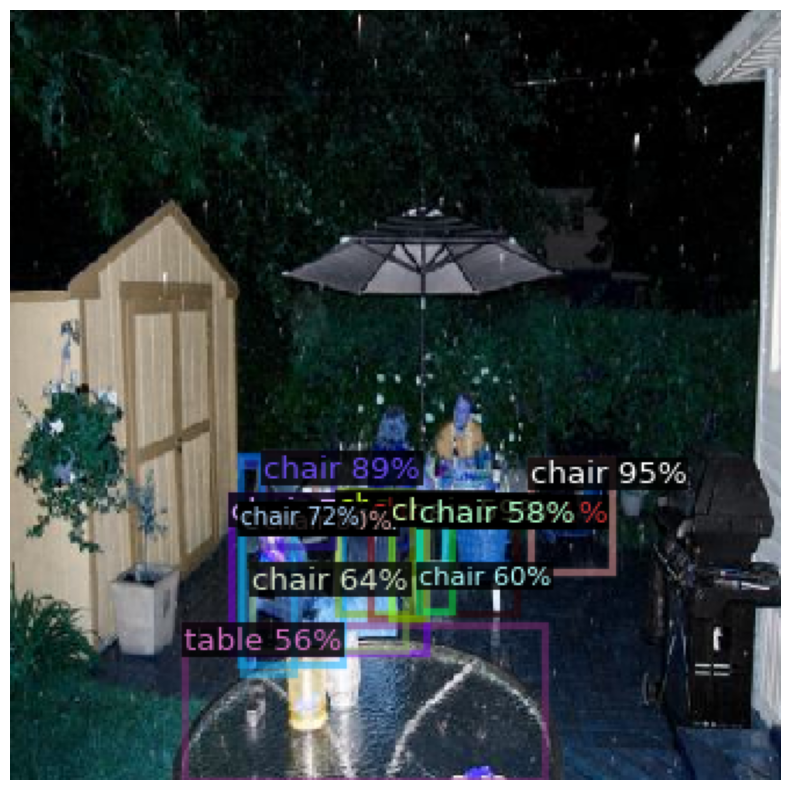

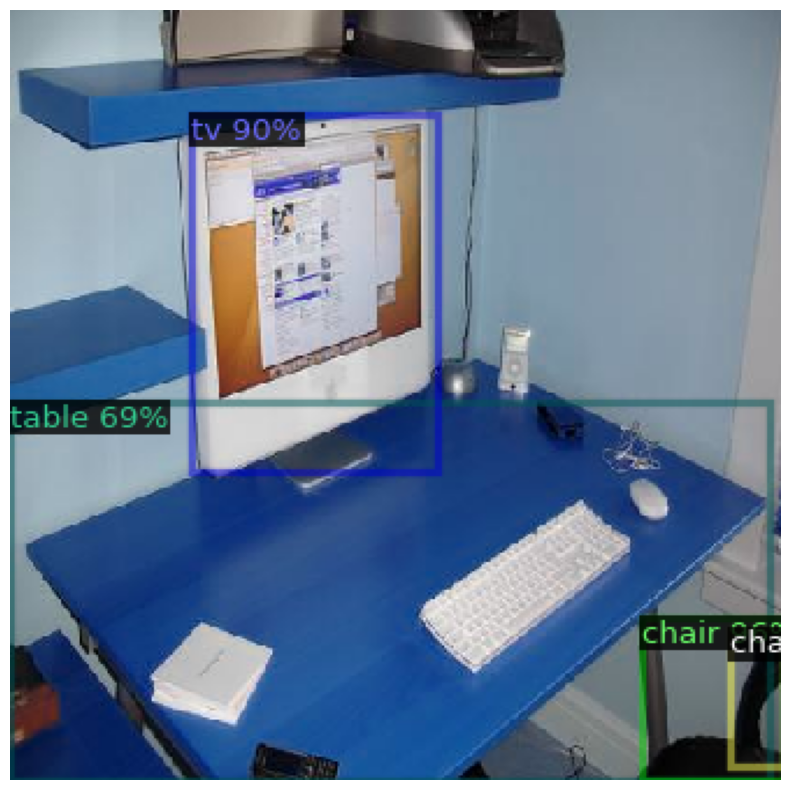

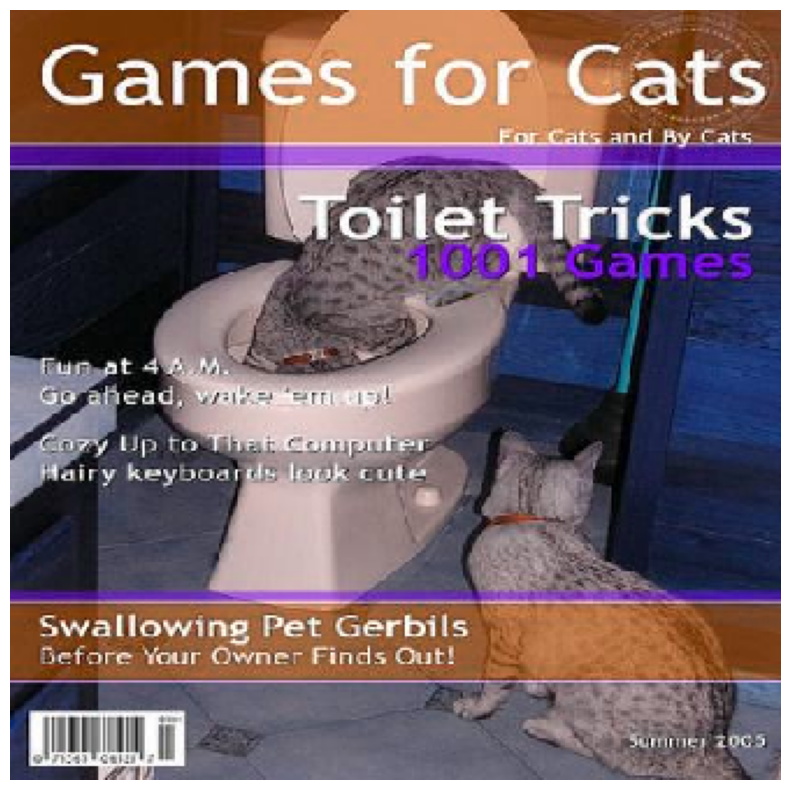

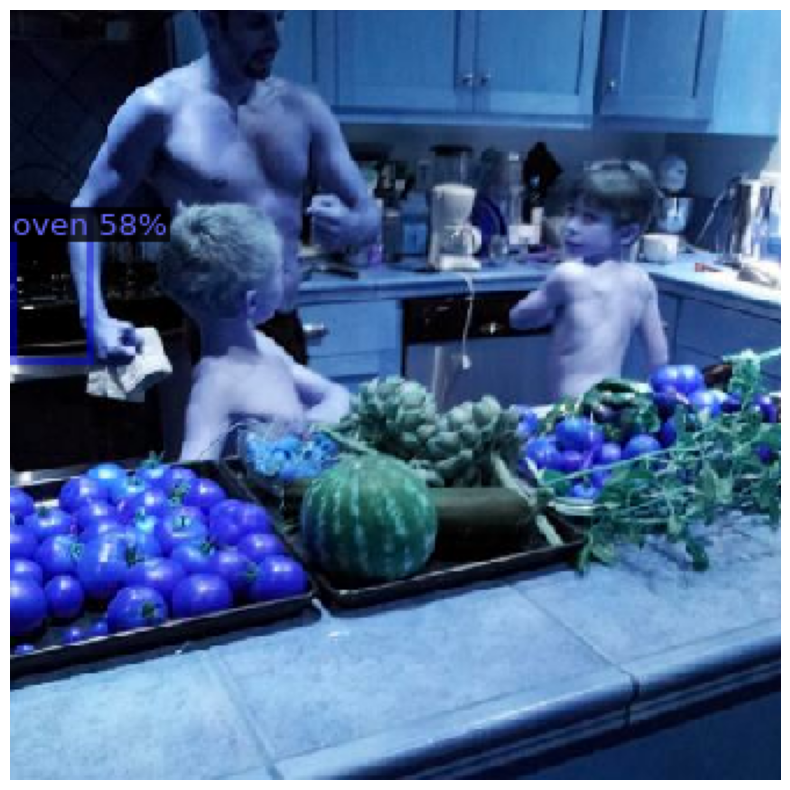

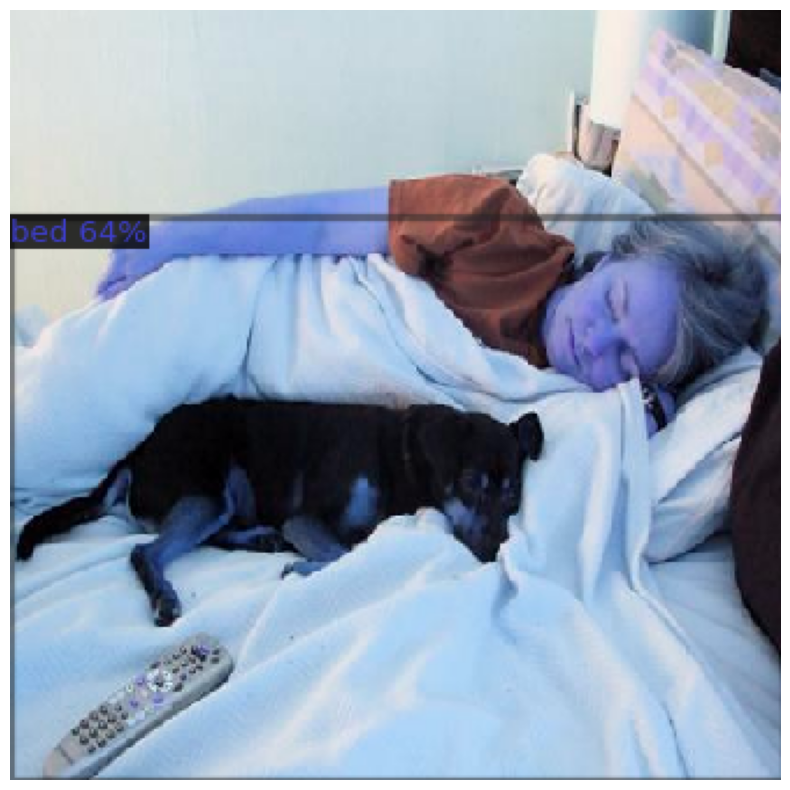

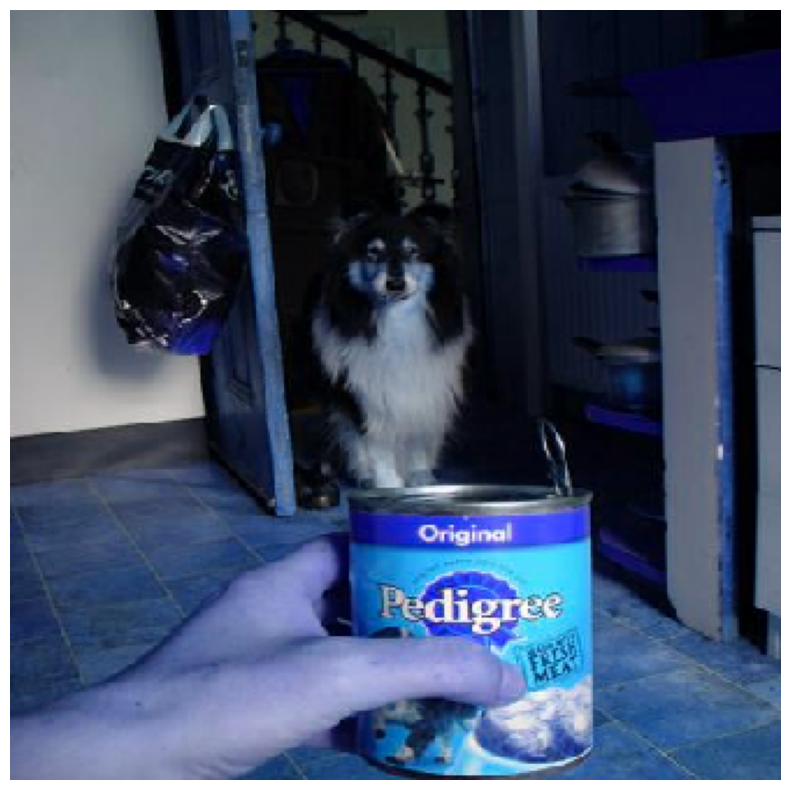

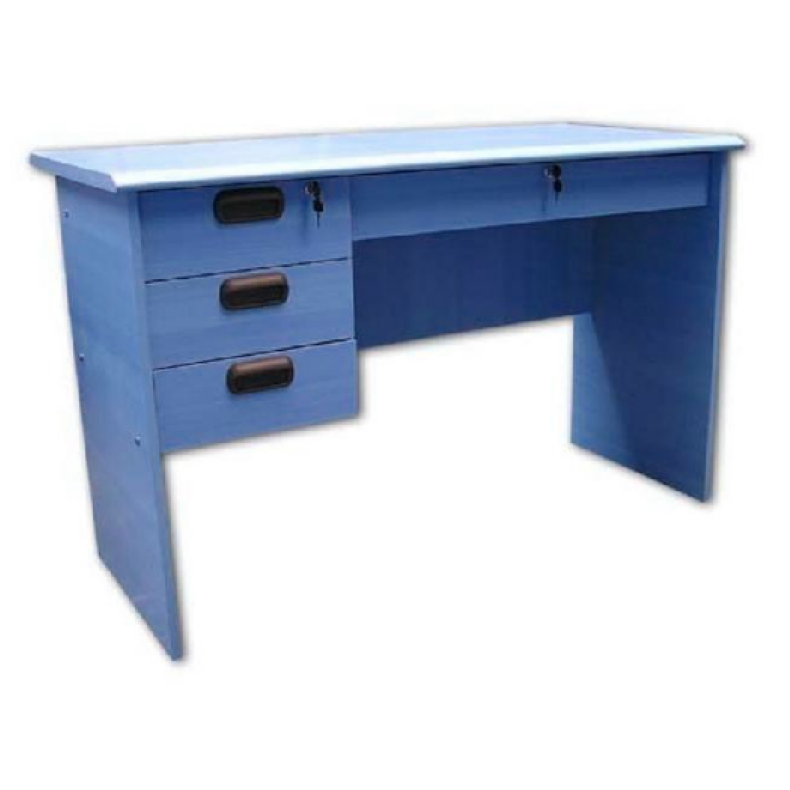

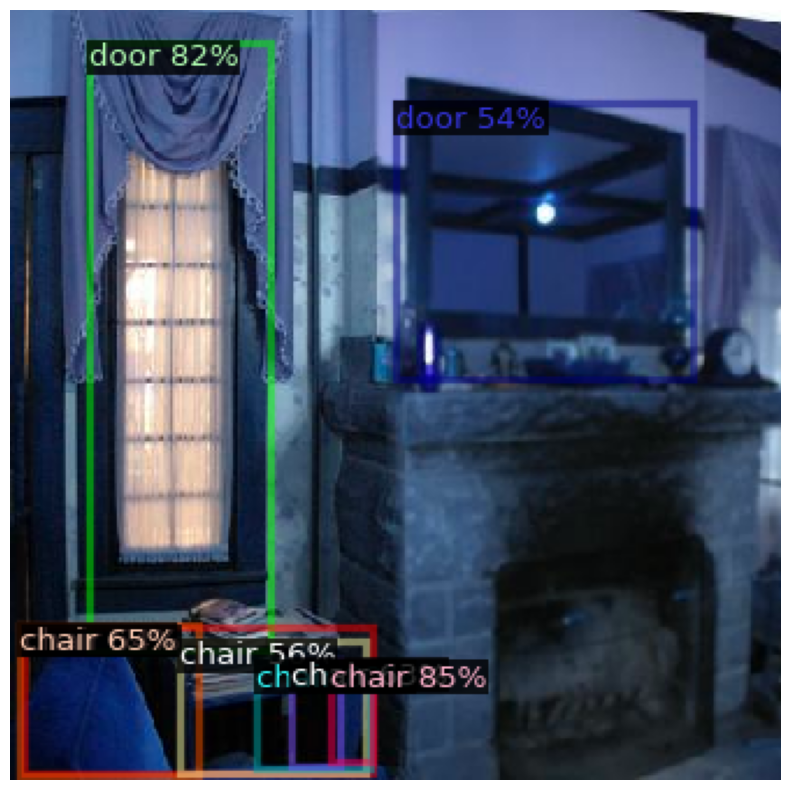

In [ ]:
import os
import random
import cv2
import matplotlib.pyplot as plt
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.utils.visualizer import Visualizer

test_metadata = MetadataCatalog.get("custom_test")
test_dataset_dicts = DatasetCatalog.get("custom_test")

os.makedirs("./outputpal/plots", exist_ok=True)  # Directory to save plotted images

# Select 10 random entries from the test dataset
random_entries = random.sample(test_dataset_dicts, 10)

for idx, d in enumerate(random_entries):  # Visualize 10 random test images
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)
    v = Visualizer(img[:, :, ::-1], metadata=test_metadata, scale=0.8)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))

    plt.figure(figsize=(14, 10))
    plt.imshow(out.get_image()[:, :, ::-1])
    plt.axis('off')

    plot_path = f"./outputpal/plots/prediction_{idx}.png"
    plt.savefig(plot_path)  # Save the plot
    plt.show()


Saving frame000051.jpg to frame000051.jpg
Saving frame000293.jpg to frame000293.jpg
Saving frame000305.jpg to frame000305 (1).jpg
Saving frame000797.jpg to frame000797.jpg
Saving frame000912.jpg to frame000912.jpg
Saving frame001218.jpg to frame001218.jpg
Saving frame001381.jpg to frame001381.jpg
Saving frame001391.jpg to frame001391.jpg
Saving frame001419.jpg to frame001419.jpg
Saving frame001429.jpg to frame001429.jpg
Saving frame001469.jpg to frame001469.jpg
Saving frame001584.jpg to frame001584.jpg
Saving frame001707.jpg to frame001707.jpg
Saving frame001720.jpg to frame001720.jpg
Saving frame001898.jpg to frame001898.jpg
Saving frame001978.jpg to frame001978.jpg
Saving frame001995.jpg to frame001995.jpg


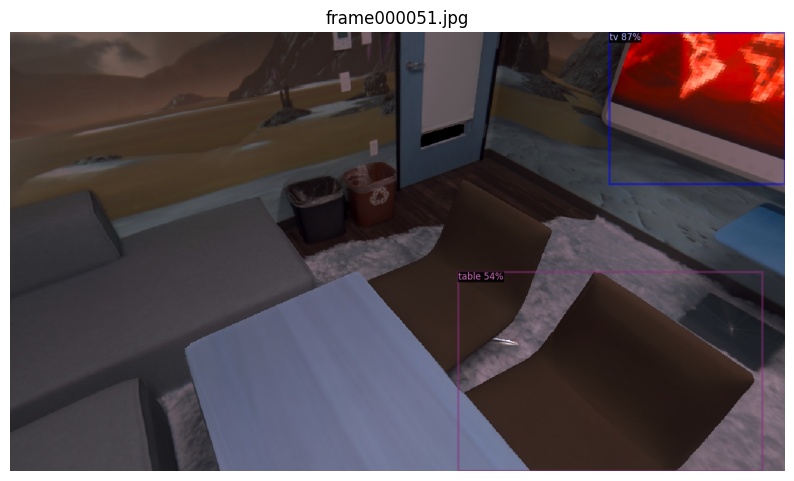

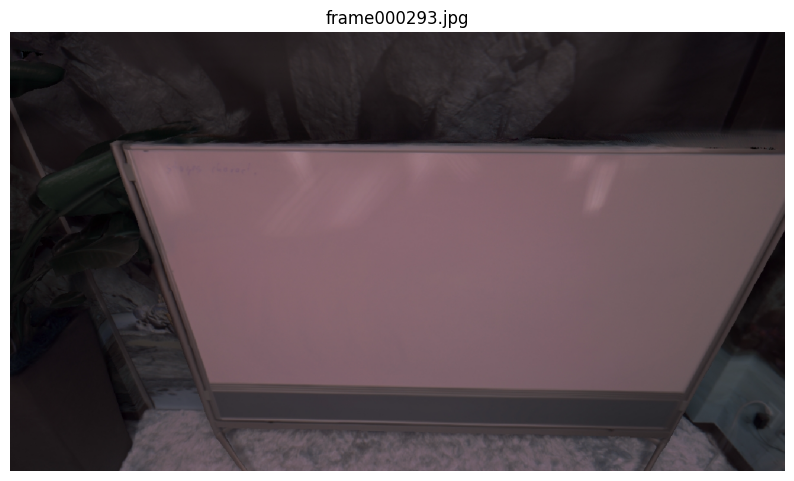

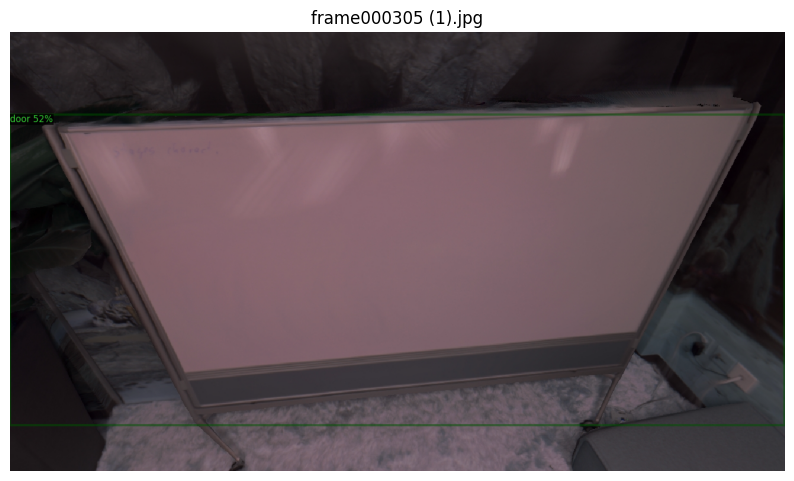

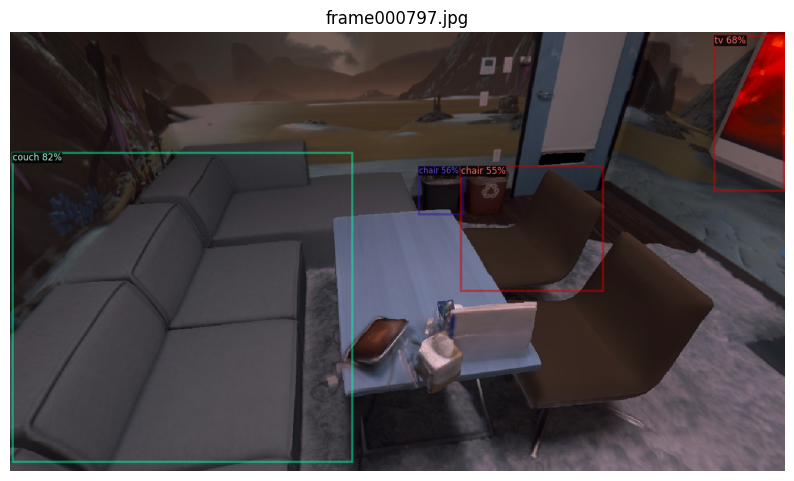

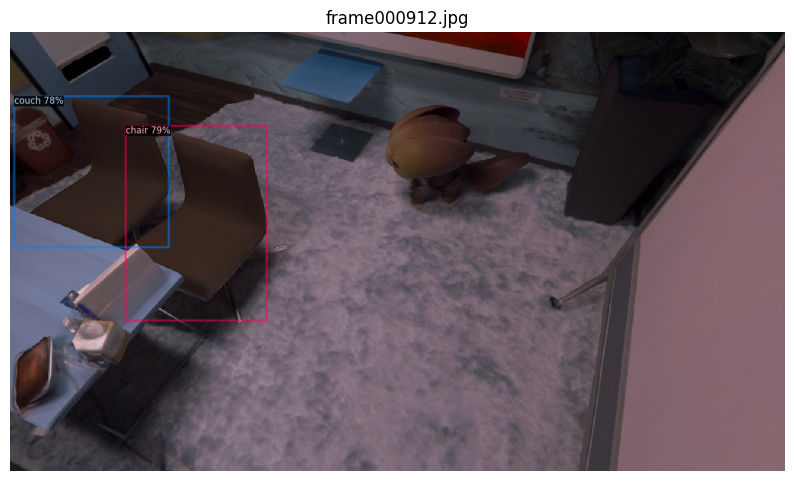

...

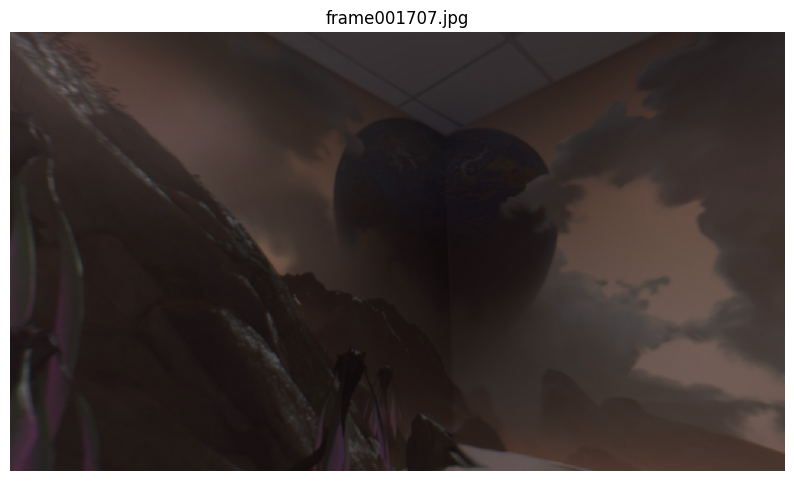

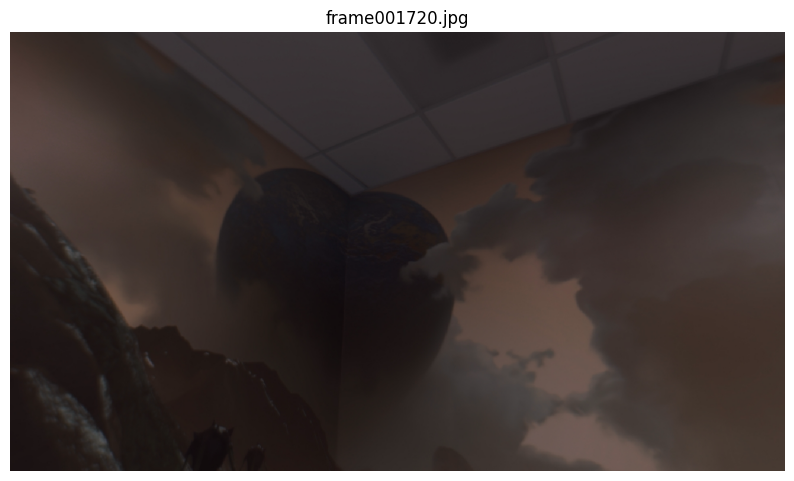

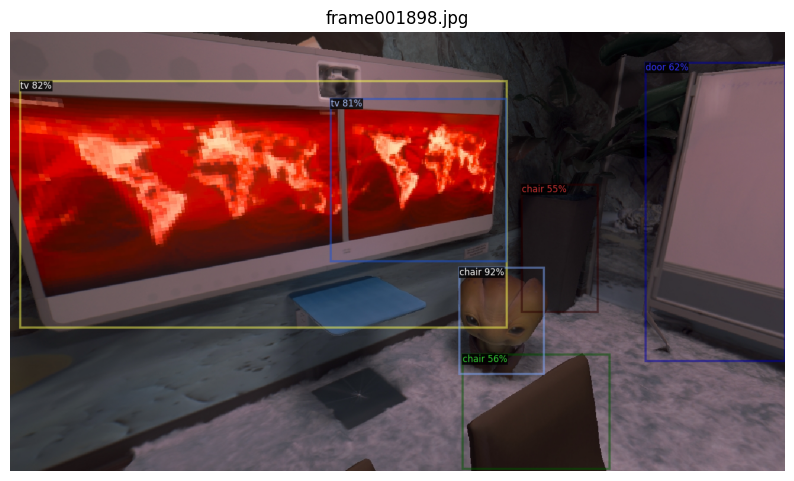

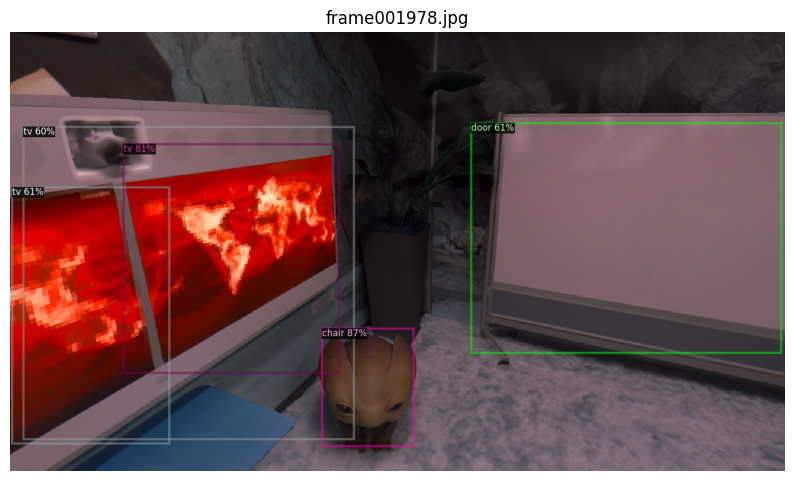

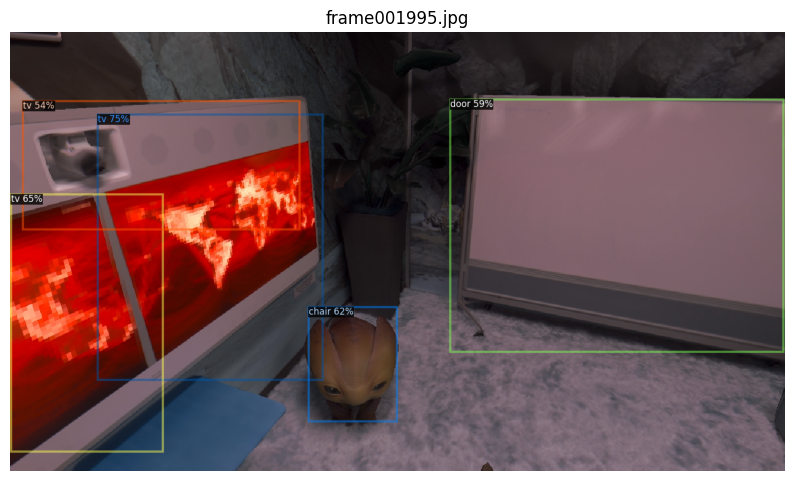

In [ ]:
 # Step 3: Upload images
from google.colab import files
import os

# Upload images
uploaded = files.upload()

# Create a directory to store uploaded images
os.makedirs("uploaded_images", exist_ok=True)

# Save uploaded images to the directory
for filename in uploaded.keys():
    with open(os.path.join("uploaded_images", filename), 'wb') as f:
        f.write(uploaded[filename])

# Step 4: Load the trained model and run inference
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
import matplotlib.pyplot as plt
import cv2


# Run the model on uploaded images
for filename in uploaded.keys():
    img_path = os.path.join("uploaded_images", filename)
    img = cv2.imread(img_path)
    outputs = predictor(img)

    v = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))

    plt.figure(figsize=(10, 10))
    plt.imshow(out.get_image()[:, :, ::-1])
    plt.axis('off')
    plt.title(filename)
    plt.show()

# Troubleshooting

In [ ]:
# Run the following if you see a locale error
import locale
locale.getpreferredencoding = lambda: "UTF-8"